In [1]:
import requests
import json
import pandas as pd
import seaborn as sb
import numpy as np
import matplotlib.pyplot as plt
import datetime as dt

In [2]:
BALSHT = requests.get('https://www.alphavantage.co/query?function=BALANCE_SHEET&symbol=AAPL&apikey=BNM3OK9KHBBVD3YZ') #api request for balance sheet for AAPL
INCSTAT = requests.get('https://www.alphavantage.co/query?function=INCOME_STATEMENT&symbol=AAPL&apikey=BNM3OK9KHBBVD3YZ') #api request for income statement for AAPL
TSERIES = requests.get('https://www.alphavantage.co/query?function=TIME_SERIES_DAILY_ADJUSTED&symbol=aapl&outputsize=full&apikey=BNM3OK9KHBBVD3YZ') 

bsolddf = pd.read_excel("AAPL BAL SHEET.xls")

isolddf = pd.read_excel("AAPL INCOME SHEET.xls")

interest = pd.read_csv('FEDFUNDS.csv',index_col=0)

In [3]:
bsdata = BALSHT.text
bsparsed = json.loads(bsdata)
bsquartdata = bsparsed['quarterlyReports']
bsquartdf = pd.DataFrame.from_dict(bsquartdata)

isdata = INCSTAT.text
isparsed = json.loads(isdata)
isquartdata = isparsed['quarterlyReports']
isquartdf = pd.DataFrame.from_dict(isquartdata)

data = TSERIES.text
parsed = json.loads(data)
tsdata = parsed['Time Series (Daily)']
tsda = pd.DataFrame.from_dict(tsdata, orient='index')
tsda_new=tsda.loc[:'2009-01-02',]

In [4]:
#price variable
price=tsda_new.drop(['1. open','2. high','3. low','4. close','6. volume','7. dividend amount','8. split coefficient'],1)
price.rename(columns={"5. adjusted close":"price"},inplace=True)
price.price = pd.to_numeric(price.price)
price.index = pd.to_datetime(price.index)
price.index=price.index.map(dt.datetime.toordinal)

In [5]:
#extracting dividends from tsda_new
dividend=tsda_new.drop(['1. open','2. high','3. low','5. adjusted close','6. volume','8. split coefficient'],1)
dividend.rename(columns={"4. close":"price","7. dividend amount":"adjusted_dividend"},inplace=True)
#cleaning of dividend data
dividend.adjusted_dividend = pd.to_numeric(dividend.adjusted_dividend)
dividend.price = pd.to_numeric(dividend.price)
dividend.index = pd.to_datetime(dividend.index)
dividend.index=dividend.index.map(dt.datetime.toordinal)
#remove zeroes
indexNames = dividend[ dividend['adjusted_dividend'] == 0 ].index
dividend.drop(indexNames , inplace=True)
#account for stock split
dividend_before_2020=dividend.loc['2020-08-07':,]
dividend_before_2020=(dividend_before_2020)/4
dividend_before_2014=dividend_before_2020.loc['2014-05-08':,]
dividend_before_2014=dividend_before_2014/7
dividend.update(dividend_before_2020)
dividend.update(dividend_before_2014)
dividend['dividend_yield'] = dividend['adjusted_dividend']/dividend['price']*100
dividend = dividend.drop(['price'],1)

In [6]:
interest.index = pd.to_datetime(interest.index)
interest.index = interest.index.map(dt.datetime.toordinal)
interest = interest.drop(interest.columns[1:], axis=1)

In [7]:
#adding variables to the dataframe
price['fed_interest'] = np.nan
price['dividend_yield'] = np.nan
price.update(interest)
price.update(dividend)

#Adding data points for quarterly dividend yield
div=0
date=4417
i=price.shape[0]-1
for date in price.index:
    if pd.isnull(price.iloc[i,2]):
        price.iloc[i,2]=div
        i-=1
    else:
        div=price.iloc[i,2]
        i-=1

price.index.names = ['Date_Ordinal']

In [8]:
lnprice = tsda_new.drop(['1. open','2. high','3. low','4. close','6. volume', '7. dividend amount', '8. split coefficient'],1)
lnprice.rename(columns={"5. adjusted close":"price"},inplace=True)

lnprice.price = pd.to_numeric(lnprice.price)
lnprice.index = pd.to_datetime(lnprice.index)
lnprice.index=lnprice.index.map(dt.datetime.toordinal)
lnprice['lnprice'] = np.log(lnprice['price'])
lnprice = lnprice.drop('price', axis = 1)

lnprice.index.name = 'Date_Ordinal'

In [9]:
merged = price.copy(deep=True)
merged['lnprice'] = np.nan
merged.update(lnprice)

In [10]:
assets_liab_new = bsquartdf[['fiscalDateEnding', 'totalAssets', 'totalLiabilities']]
assets_liab_new[['totalAssets', 'totalLiabilities']] = assets_liab_new[['totalAssets', 'totalLiabilities']].apply(pd.to_numeric)
assets_liab_old = bsolddf[['Period End Date', 'TOTAL ASSETS', 'TOTAL LIABILITIES']]
new_cols = {x: y for x, y in zip(assets_liab_old.columns, assets_liab_new.columns)}
assets_liab = assets_liab_new.append(assets_liab_old.rename(columns=new_cols))
assets_liab.set_index('fiscalDateEnding', inplace=True)
assets_liab.index = pd.to_datetime(assets_liab.index)

assets_liab.loc['2019-06-30', 'totalLiabilities'] = 225783000000
assets_liab.loc['2019-03-31', 'totalLiabilities'] = 236138000000
assets_liab.loc['2018-12-31', 'totalLiabilities'] = 255827000000
assets_liab.loc['2018-09-30', 'totalLiabilities'] = 258578000000

C:\Users\jovin\anaconda3\lib\site-packages\pandas\core\frame.py:3065: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[k1] = value[k2]


In [11]:
profits_new = isquartdf[['fiscalDateEnding', 'grossProfit']]
profits_new.grossProfit = pd.to_numeric(profits_new.grossProfit)
profits_old = isolddf[['Period End Date', 'Gross Profit']]
new_cols = {x: y for x, y in zip(profits_old.columns, profits_new.columns)}
profits = profits_new.append(profits_old.rename(columns=new_cols))
profits.set_index('fiscalDateEnding', inplace=True)
profits.index = pd.to_datetime(profits.index)

C:\Users\jovin\anaconda3\lib\site-packages\pandas\core\generic.py:5168: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


In [12]:
assets_liab_ordinal = assets_liab.copy(deep=True)
assets_liab_ordinal.index = assets_liab_ordinal.index.map(dt.datetime.toordinal)
profits_ordinal = profits.copy(deep=True)
profits_ordinal.index = profits_ordinal.index.map(dt.datetime.toordinal)

db_clean = pd.DataFrame({'Date_Ordinal': tsda_new.index, 'totalAssets': np.nan, 'totalLiabilities': np.nan, 'grossProfit': np.nan})
db_clean['Date_Ordinal'] = pd.to_datetime(db_clean['Date_Ordinal'])
db_clean = db_clean.set_index('Date_Ordinal')
db_clean.index = db_clean.index.map(dt.datetime.toordinal)

In [13]:
i = 0
date = assets_liab_ordinal.index[i]

for d in db_clean.index:
    if d >= date:
        db_clean.loc[d, 'totalAssets'] = assets_liab_ordinal.iloc[i, 0]
        db_clean.loc[d, 'totalLiabilities'] = assets_liab_ordinal.iloc[i, 1]
        db_clean.loc[d, 'grossProfit'] = profits_ordinal.iloc[i, 0]
    else:
        i = i+1
        date = assets_liab_ordinal.index[i]
        db_clean.loc[d, 'totalAssets'] = assets_liab_ordinal.iloc[i, 0]
        db_clean.loc[d, 'totalLiabilities'] = assets_liab_ordinal.iloc[i, 1]
        db_clean.loc[d, 'grossProfit'] = profits_ordinal.iloc[i, 0]

In [14]:
merged['totalAssets'] = np.nan
merged['totalLiabilities'] = np.nan
merged['grossProfit'] = np.nan

In [15]:
merged.update(db_clean)
merged.insert(0, "Date", merged.index.map(dt.datetime.fromordinal))
merged.insert(0, "dateOrd", merged.index)

In [16]:
merged.describe()

,dateOrd,price,fed_interest,dividend_yield,lnprice,totalAssets,totalLiabilities,grossProfit
count,3092.000000,3092.000000,3092.000000,3092.000000,3092.000000,3.092000e+03,3.092000e+03,3.092000e+03
mean,735651.380336,32.038452,0.544136,0.303781,3.115034,2.324254e+11,1.353466e+11,1.852112e+10
std,1295.573345,28.927230,0.717853,0.223156,0.859902,1.121674e+11,9.108437e+10,8.816917e+09
min,733409.000000,2.405355,0.050000,0.000000,0.877698,4.278700e+10,1.586100e+10,3.627000e+09
25%,734528.750000,12.954007,0.100000,0.000000,2.561405,1.386810e+11,4.843600e+10,1.302400e+10
50%,735653.500000,23.181504,0.160000,0.387083,3.143354,2.611940e+11,1.321880e+11,1.968100e+10
75%,736773.250000,41.378662,0.660000,0.451663,3.722765,3.311410e+11,2.342480e+11,2.268000e+10
max,737895.000000,142.945728,2.420000,0.667732,4.962465,4.067940e+11,2.878300e+11,4.432800e+10


In [17]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler(feature_range=(1, 5))
scaler1 = MinMaxScaler(feature_range=(0, 1))

merged['dateOrd'] = merged['dateOrd'] - 733409

merged[['totalAssets', 'totalLiabilities', 'grossProfit']] = scaler.fit_transform(merged[['totalAssets', 'totalLiabilities', 'grossProfit']].values)

merged[['dateOrd']] = scaler1.fit_transform(merged[['dateOrd']])

In [18]:
merged.describe()

,dateOrd,price,fed_interest,dividend_yield,lnprice,totalAssets,totalLiabilities,grossProfit
count,3092.000000,3092.000000,3092.000000,3092.000000,3092.000000,3092.000000,3092.000000,3092.000000
mean,0.499862,32.038452,0.544136,0.303781,3.115034,3.083898,2.757342,2.463759
std,0.288804,28.927230,0.717853,0.223156,0.859902,1.232585,1.339629,0.866506
min,0.000000,2.405355,0.050000,0.000000,0.877698,1.000000,1.000000,1.000000
25%,0.249610,12.954007,0.100000,0.000000,2.561405,2.053760,1.479099,1.923515
50%,0.500334,23.181504,0.160000,0.387083,3.143354,3.400031,2.710886,2.577750
75%,0.749944,41.378662,0.660000,0.451663,3.722765,4.168664,4.211940,2.872485
max,1.000000,142.945728,2.420000,0.667732,4.962465,5.000000,5.000000,5.000000


<AxesSubplot:xlabel='Date', ylabel='Value'>

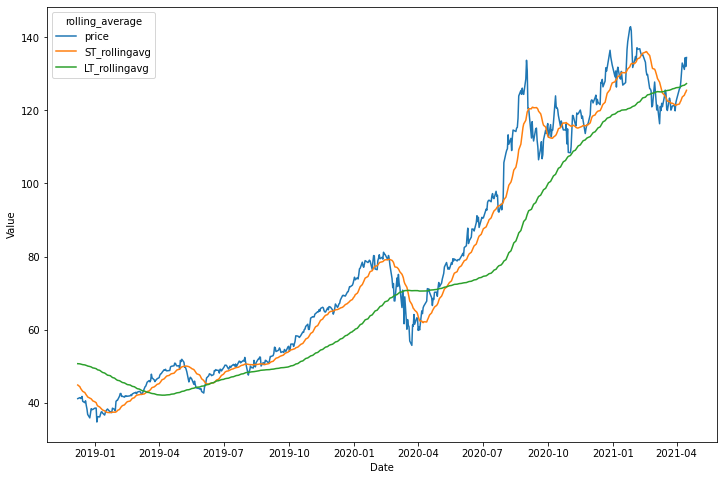

In [19]:
rollingavg = merged[['Date', 'price']]
rollingavg = rollingavg.iloc[::-1]
rollingavg['ST_rollingavg'] = rollingavg.rolling(window = 20)['price'].mean()
rollingavg['LT_rollingavg'] = rollingavg.rolling(window = 100)['price'].mean()
rollingavg = rollingavg.iloc[2500:]
RAmelt = pd.melt(rollingavg, 'Date', var_name='rolling_average', value_name='Value')
f = plt.figure(figsize=(12, 8))
sb.lineplot(x='Date', y='Value', hue='rolling_average', data = RAmelt)


<AxesSubplot:xlabel='Date', ylabel='grossProfit'>

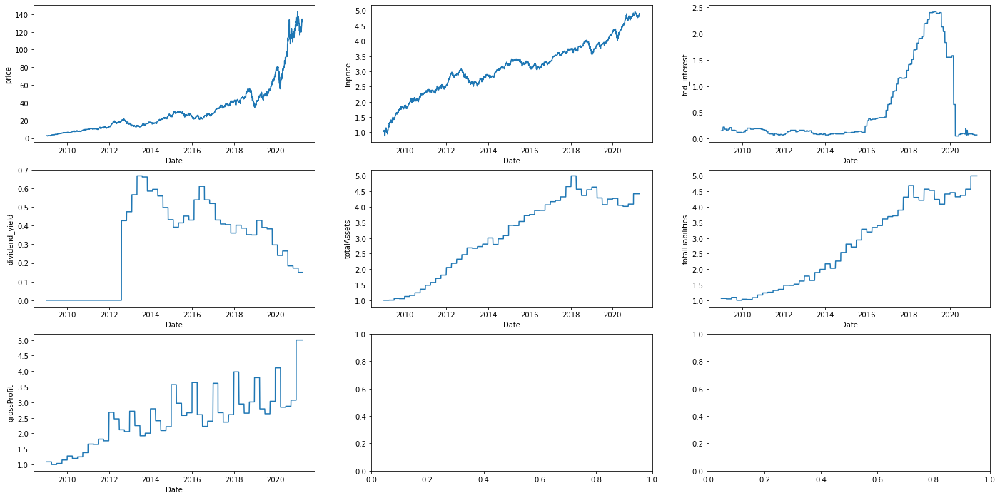

In [20]:
f, axes = plt.subplots(3, 3, figsize=(24, 12))
sb.lineplot(data = merged, x='Date', y='price', ax=axes[0,0])
sb.lineplot(data = merged, x='Date', y='lnprice', ax=axes[0,1])
sb.lineplot(data = merged, x='Date', y='fed_interest', ax=axes[0,2])
sb.lineplot(data = merged, x='Date', y='dividend_yield', ax=axes[1,0])
sb.lineplot(data = merged, x='Date', y='totalAssets', ax=axes[1,1])
sb.lineplot(data = merged, x='Date', y='totalLiabilities', ax=axes[1,2])
sb.lineplot(data = merged, x='Date', y='grossProfit', ax=axes[2,0])

<AxesSubplot:>

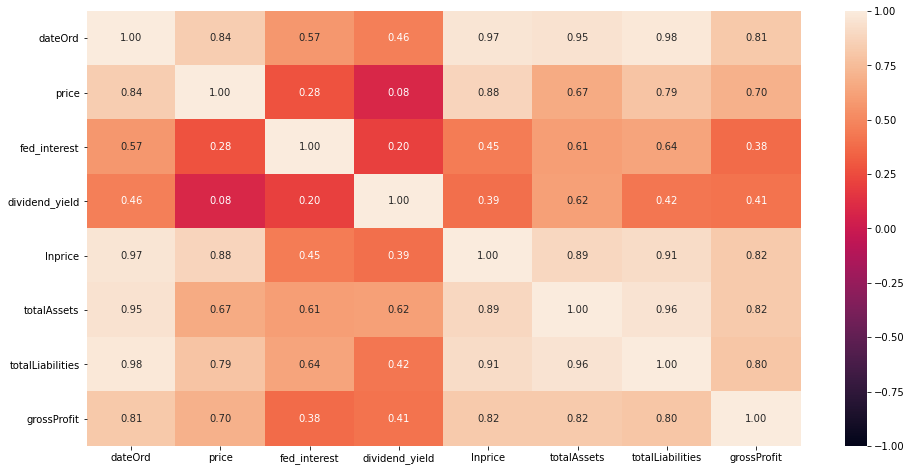

In [21]:
f = plt.figure(figsize=(16, 8))
sb.heatmap(merged.corr(), vmin = -1, vmax = 1, annot = True, fmt=".2f")

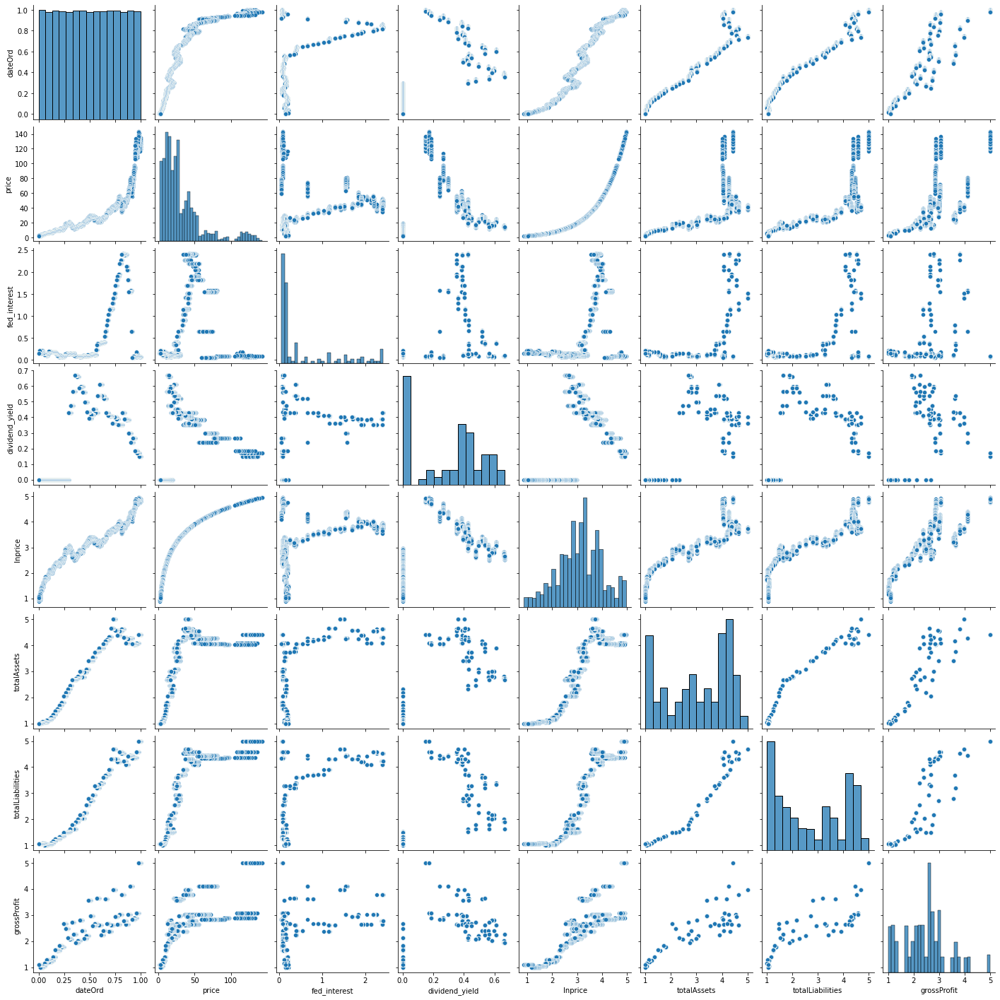

In [22]:
sb.pairplot(merged)

In [23]:
y = pd.DataFrame(merged['lnprice'])
X = pd.DataFrame(merged[['dateOrd', 'fed_interest', 'dividend_yield', 'totalAssets', 'totalLiabilities', 'grossProfit']])

X_test = X[0:int(0.25*X.shape[0])]
X_train = X[int(0.25*X.shape[0]):]
y_test = y[0:int(0.25*X.shape[0])]
y_train = y[int(0.25*X.shape[0]):]

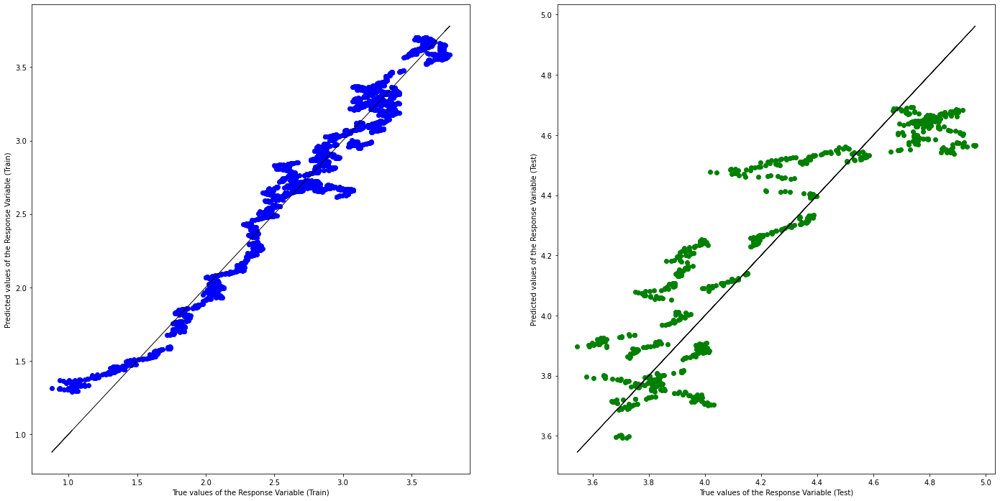

In [25]:
from sklearn.linear_model import LinearRegression

linreg = LinearRegression()
linreg.fit(X_train, y_train)

y_train_pred = linreg.predict(X_train)
y_test_pred = linreg.predict(X_test)

f, axes = plt.subplots(1, 2, figsize=(24, 12))
axes[0].scatter(y_train, y_train_pred, color = "blue")
axes[0].plot(y_train, y_train, 'k-', linewidth = 1)
axes[0].set_xlabel("True values of the Response Variable (Train)")
axes[0].set_ylabel("Predicted values of the Response Variable (Train)")
axes[1].scatter(y_test, y_test_pred, color = "green")
axes[1].plot(y_test, y_test, 'k-', linewidth = 1)
axes[1].set_xlabel("True values of the Response Variable (Test)")
axes[1].set_ylabel("Predicted values of the Response Variable (Test)")
plt.show()

,lnprice,lnprice_pred,Date_Ordinal,price,price_pred
Date_Ordinal,,,,,
737895,4.901564,4.679574,737895,134.500000,107.724123
737894,4.883029,4.678438,737894,132.030000,107.601836
737893,4.901044,4.677302,737893,134.430000,107.479687
737892,4.877028,4.676166,737892,131.240000,107.357678
737889,4.890312,4.672759,737889,132.995000,106.992478
...,...,...,...,...,...
736780,3.703751,3.600607,736780,40.599323,36.620471
736779,3.729727,3.599472,736779,41.667726,36.578900
736776,3.683347,3.596064,736776,39.779330,36.454469


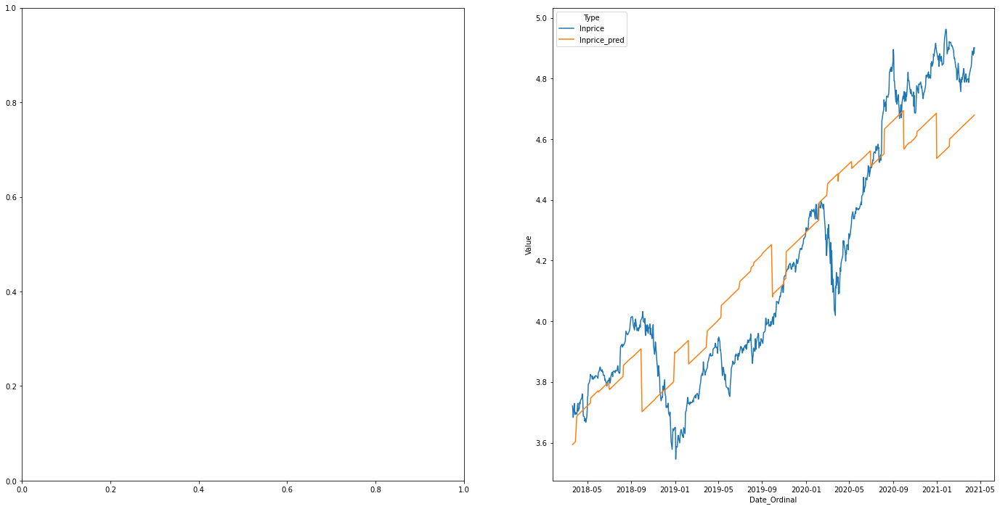

In [35]:
results = pd.concat([y_test, pd.DataFrame(y_test_pred, columns=['lnprice_pred']).set_index(y_test.index), pd.DataFrame(y_test.index).set_index(y_test.index)], axis = 1)
results1 = results.copy(deep=True)
results1['price'] = np.exp(results['lnprice'])
results1['price_pred'] = np.exp(results['lnprice_pred'])
results1.drop(['lnprice', 'lnprice_pred'], 1)
resultsmelt = pd.melt(results, 'Date_Ordinal', var_name='Type', value_name='Value')
resultsmelt1 = pd.melt(results1, 'Date_Ordinal', var_name='Type', value_name='Value')
f, axes = plt.subplots(1, 2, figsize=(24, 12))
sb.lineplot(x=resultsmelt.Date_Ordinal.map(dt.datetime.fromordinal), y='Value', hue='Type', data = resultsmelt)
results1


In [27]:
print('Intercept of Regression \t: b = ', linreg.intercept_)
print('Coefficients of Regression \t: a = ', linreg.coef_)
print()
pd.DataFrame(list(zip(X_train.columns, linreg.coef_[0])), columns = ["Predictors", "Coefficients"])

Intercept of Regression 	: b =  [1.67889207]
Coefficients of Regression 	: a =  [[ 5.09535393 -0.03865577 -1.00489195  0.46158679 -0.82298275  0.0266313 ]]



,Predictors,Coefficients
0,dateOrd,5.095354
1,fed_interest,-0.038656
2,dividend_yield,-1.004892
3,totalAssets,0.461587
4,totalLiabilities,-0.822983
5,grossProfit,0.026631


In [30]:
from sklearn.metrics import mean_squared_error

print("Goodness of Fit of Model \t\tTrain Dataset")
print("Explained Variance (R^2) \t\t:", linreg.score(X_train, y_train))
print("Adjusted Explained Variance (R^2) \t:", (1 - (1 - linreg.score(X_train, y_train)) * ((X_train.shape[0] - 1) / (X_train.shape[0] - X_train.shape[1] - 1))))
print("Root Mean Squared Error (RMSE) \t\t:", mean_squared_error(y_train, y_train_pred, squared=False))
print()

print("Goodness of Fit of Model \t\tTest Dataset")
print("Explained Variance (R^2) \t\t:", linreg.score(X_test, y_test))
print("Adjusted Explained Variance (R^2) \t:", (1 - (1 - linreg.score(X_test, y_test)) * ((X_test.shape[0] - 1) / (X_test.shape[0] - X_test.shape[1] - 1))))
print("Root Mean Squared Error (RMSE) \t\t:", mean_squared_error(y_test, y_test_pred, squared=False))
print()

Goodness of Fit of Model 		Train Dataset
Explained Variance (R^2) 		: 0.9616781604818523
Adjusted Explained Variance (R^2) 	: 0.9615787093412342
Root Mean Squared Error (RMSE) 		: 0.12726358676504806

Goodness of Fit of Model 		Test Dataset
Explained Variance (R^2) 		: 0.810235969351938
Adjusted Explained Variance (R^2) 	: 0.808749567023102
Root Mean Squared Error (RMSE) 		: 0.17527776544629953

